In [6]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from scipy.spatial import cKDTree


In [7]:
file_name = 'data/df_trainer_processed.csv'
df = pd.read_csv(file_name)

In [8]:
df

,Classification,Original_cloud_index,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,axial_inch_round,vertical_inch_round,min_in_window,relative_vertical_inch
0,2,0,0.330174,0.871877,0.393169,3.962087,10.462519,4.718032,3.9375,10.4375,4.6875,0.0,4.6875
1,2,0,0.111604,0.746168,0.350633,1.339252,8.954014,4.207599,1.3125,8.9375,4.1875,0.0,4.1875
2,2,0,0.317910,1.246824,0.386342,3.814921,14.961891,4.636103,3.8125,14.9375,4.6250,0.0,4.6250
3,2,0,0.114570,2.703832,0.327411,1.374843,32.445984,3.928936,1.3750,32.4375,3.9375,0.0,3.9375
4,2,0,0.115709,1.795413,0.386273,1.388504,21.544961,4.635275,1.3750,21.5625,4.6250,0.0,4.6250
...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,4,3,0.416138,0.036854,0.029596,4.993662,0.442243,0.355158,5.0000,0.4375,0.3750,0.0,0.3750
199996,4,3,0.420961,0.415016,0.012598,5.051536,4.980196,0.151181,5.0625,5.0000,0.1250,0.0,0.1250
199997,4,3,0.023346,2.614797,0.026030,0.280157,31.377559,0.312362,0.2500,31.3750,0.3125,0.0,0.3125
199998,4,3,0.001424,2.521588,0.005614,0.017087,30.259055,0.067363,0.0000,30.2500,0.0625,0.0,0.0625


In [9]:
# GOAL
'''
Eigenvectors and Eigenvalues

Geometric features for clustering

'''

'\nEigenvectors and Eigenvalues\n\nGeometric features for clustering\n\n'

In [10]:
def _pca_cov(points):
    if points.shape[0] < 3:
        return None, None, None, None
    mu = points.mean(axis=0)
    X = points - mu
    C = (X.T @ X) / max(len(points), 1)          # covariance (scale factor cancels if we normalize eigs)
    evals, evecs = np.linalg.eigh(C)             # ascending
    order = np.argsort(evals)[::-1]              # sort to λ1≥λ2≥λ3
    evals = evals[order]
    evecs = evecs[:, order]                      # columns are e1,e2,e3
    return mu, C, evals, evecs

def _first_order_moment(points, mu, n):
    if points is None or mu is None or n is None:
        return np.nan
    return np.abs((points - mu) @ n).mean()      # mean absolute point-to-plane distance

def compute_features_for_df(
    df: pd.DataFrame,
    x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
    radius: float | None = None,
    k_neighbors: int | None = None,
    normalize_eigs: bool = True,      # if True, λ1+λ2+λ3 = 1 (scale-invariant)
    up_vector=(0.0, 0.0, 1.0),
    include_normals: bool = True,
    orient_normals_to_up: bool = True,
    eps: float = 1e-12
) -> pd.DataFrame:
    assert (radius is None) ^ (k_neighbors is None), "Specify exactly one of radius or k_neighbors"

    xyz = df[[x_col, y_col, z_col]].to_numpy(dtype=np.float64)
    N = xyz.shape[0]
    tree = cKDTree(xyz)

    # Precompute neighbors (vectorized KD query is faster)
    if radius is not None:
        # Variable-size neighborhoods; we’ll query per-point
        neighbor_lists = None
    else:
        dists, idxs = tree.query(xyz, k=k_neighbors)   # shape: (N, k)
        neighbor_lists = idxs

    up = np.asarray(up_vector, dtype=float)
    up = up / (np.linalg.norm(up) + eps)

    # Allocate arrays
    lam1 = np.full(N, np.nan); lam2 = np.full(N, np.nan); lam3 = np.full(N, np.nan)
    ev1x = np.full(N, np.nan); ev1y = np.full(N, np.nan); ev1z = np.full(N, np.nan)
    ev2x = np.full(N, np.nan); ev2y = np.full(N, np.nan); ev2z = np.full(N, np.nan)
    ev3x = np.full(N, np.nan); ev3y = np.full(N, np.nan); ev3z = np.full(N, np.nan)

    eigen_sum       = np.full(N, np.nan)
    omnivariance    = np.full(N, np.nan)
    eigenentropy    = np.full(N, np.nan)
    anisotropy      = np.full(N, np.nan)
    planarity       = np.full(N, np.nan)
    linearity       = np.full(N, np.nan)
    surface_var     = np.full(N, np.nan)
    sphericity      = np.full(N, np.nan)
    pca1            = np.full(N, np.nan)
    pca2            = np.full(N, np.nan)
    verticality     = np.full(N, np.nan)
    O_moment        = np.full(N, np.nan)
    n_count         = np.zeros(N, dtype=int)

    if include_normals:
        Nx = np.full(N, np.nan); Ny = np.full(N, np.nan); Nz = np.full(N, np.nan)

    # Iterate points
    for i in range(N):
        if radius is None:
            idx = neighbor_lists[i]
        else:
            idx = tree.query_ball_point(xyz[i], r=radius)
        P = xyz[idx]
        n_count[i] = len(P)
        if len(P) < 3:
            continue

        mu, C, evals, evecs = _pca_cov(P)
        if evals is None:
            continue

        # Raw eigenvalues
        L1, L2, L3 = evals
        S = max(L1 + L2 + L3, eps)

        if normalize_eigs:
            l1, l2, l3 = L1/S, L2/S, L3/S
        else:
            l1, l2, l3 = L1, L2, L3

        e1, e2, e3 = evecs[:,0], evecs[:,1], evecs[:,2]

        # Store eigenvalues (normalized or raw depending on flag)
        lam1[i], lam2[i], lam3[i] = l1, l2, l3

        # Store eigenvectors
        ev1x[i], ev1y[i], ev1z[i] = e1
        ev2x[i], ev2y[i], ev2z[i] = e2
        ev3x[i], ev3y[i], ev3z[i] = e3

        # Feature set (CloudCompare / Hackel et al.)
        eigen_sum[i]    = S if not normalize_eigs else (L1 + L2 + L3)    # raw trace as scale proxy
        omnivariance[i] = max(l1*l2*l3, 0.0) ** (1.0/3.0)
        e1c, e2c, e3c   = max(l1, eps), max(l2, eps), max(l3, eps)
        eigenentropy[i] = -(e1c*np.log(e1c) + e2c*np.log(e2c) + e3c*np.log(e3c))
        anisotropy[i]   = (l1 - l3) / (l1 + eps)
        planarity[i]    = (l2 - l3) / (l1 + eps)
        linearity[i]    = (l1 - l2) / (l1 + eps)
        surface_var[i]  = l3 / (l1 + l2 + l3 + eps)
        sphericity[i]   = l3 / (l1 + eps)
        denom           = (l1 + l2 + l3 + eps)
        pca1[i]         = l1 / denom
        pca2[i]         = l2 / denom

        # Verticality: 1 - |<up, e3>|
        v = 1.0 - abs(float(np.dot(up, e3)))
        verticality[i] = v

        # First-order moment O: mean |point-to-plane| using e3, plane through μ
        O_moment[i] = _first_order_moment(P, mu, e3)

        # Optional normal export (use e3, smallest-eigenvalue dir). Optionally orient to up.
        if include_normals:
            nvec = e3.copy()
            if orient_normals_to_up and np.dot(nvec, up) < 0:
                nvec = -nvec
            Nx[i], Ny[i], Nz[i] = nvec

    # Assemble DataFrame with consistent column names
    feat = pd.DataFrame({
        'lam1': lam1, 'lam2': lam2, 'lam3': lam3,
        'e1x': ev1x, 'e1y': ev1y, 'e1z': ev1z,
        'e2x': ev2x, 'e2y': ev2y, 'e2z': ev2z,
        'e3x': ev3x, 'e3y': ev3y, 'e3z': ev3z,
        'eigen_sum': eigen_sum,
        'omnivariance': omnivariance,
        'eigenentropy': eigenentropy,
        'anisotropy': anisotropy,
        'planarity': planarity,
        'linearity': linearity,
        'surface_variation': surface_var,
        'sphericity': sphericity,
        'pca1': pca1,
        'pca2': pca2,
        'verticality': verticality,
        'O': O_moment,
        'neighbors': n_count
    }, index=df.index)

    if include_normals:
        feat[['Nx', 'Ny', 'Nz']] = np.column_stack([Nx, Ny, Nz])

    return pd.concat([df, feat], axis=1)


In [11]:
df = compute_features_for_df(
     df,
     x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
     radius=1.0,
     normalize_eigs=True,
     k_neighbors=None,
     up_vector=(0,0,1),
     include_normals=True,
     orient_normals_to_up=True
 )

df

,Classification,Original_cloud_index,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,axial_inch_round,...,surface_variation,sphericity,pca1,pca2,verticality,O,neighbors,Nx,Ny,Nz
0,2,0,0.330174,0.871877,0.393169,3.962087,10.462519,4.718032,3.9375,10.4375,...,0.084266,0.160183,0.526061,0.389673,0.584957,0.156836,1150,0.909802,-0.000799,0.415043
1,2,0,0.111604,0.746168,0.350633,1.339252,8.954014,4.207599,1.3125,8.9375,...,0.077296,0.152374,0.507277,0.415427,0.846429,0.162144,1363,0.988133,0.003145,0.153571
2,2,0,0.317910,1.246824,0.386342,3.814921,14.961891,4.636103,3.8125,14.9375,...,0.109690,0.222984,0.491921,0.398389,0.650970,0.194238,1344,0.937112,0.000326,0.349030
3,2,0,0.114570,2.703832,0.327411,1.374843,32.445984,3.928936,1.3750,32.4375,...,0.044343,0.089848,0.493534,0.462123,0.530050,0.115686,1177,0.882693,-0.000415,0.469950
4,2,0,0.115709,1.795413,0.386273,1.388504,21.544961,4.635275,1.3750,21.5625,...,0.097707,0.193681,0.504472,0.397822,0.657108,0.175660,1317,-0.939353,0.006357,0.342892
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,4,3,0.416138,0.036854,0.029596,4.993662,0.442243,0.355158,5.0000,0.4375,...,0.030801,0.054373,0.566476,0.402723,0.070580,0.079433,721,0.368862,-0.010890,0.929420
199996,4,3,0.420961,0.415016,0.012598,5.051536,4.980196,0.151181,5.0625,5.0000,...,0.025846,0.036532,0.707489,0.266665,0.075704,0.082968,802,0.381674,-0.001266,0.924296
199997,4,3,0.023346,2.614797,0.026030,0.280157,31.377559,0.312362,0.2500,31.3750,...,0.021967,0.032547,0.674937,0.303095,0.066753,0.077948,865,-0.359234,-0.000496,0.933247
199998,4,3,0.001424,2.521588,0.005614,0.017087,30.259055,0.067363,0.0000,30.2500,...,0.030213,0.040185,0.751866,0.217920,0.101195,0.083942,591,-0.438336,0.003353,0.898805


In [12]:
def fibonacci_hemisphere(n_dirs=256, seed=None):
    """Global +Z hemisphere directions (Fibonacci/golden-angle)."""
    rng = np.random.default_rng(seed)
    ga = np.pi * (3.0 - np.sqrt(5.0))
    k  = np.arange(n_dirs, dtype=float)
    z  = 1.0 - 2.0 * (k + 0.5) / n_dirs
    r  = np.sqrt(np.clip(1.0 - z*z, 0, 1))
    phi = k * ga
    dirs = np.column_stack([r * np.cos(phi), r * np.sin(phi), z])
    dirs = dirs[dirs[:, 2] >= 0.0]  # keep global +Z hemisphere
    # normalize numerically
    dirs /= (np.linalg.norm(dirs, axis=1, keepdims=True) + 1e-12)
    return dirs  # (M,3)

def compute_pcv_global_sky(
    df: pd.DataFrame,
    x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
    rays=256,
    r_max=24.0,                # try 24-60 inches to start, depending on scene scale
    cone_half_angle_deg=4.0,
    jitter=True,               # rotate directions slightly around +Z per point to avoid banding
    jitter_deg=3.0,            # +/-deg random azimuthal rotation
    write_col='Illuminance_(PCV)',
    verbose=True
) -> pd.DataFrame:
    xyz = df[[x_col, y_col, z_col]].to_numpy(np.float64)
    N   = xyz.shape[0]
    tree = cKDTree(xyz)

    base_dirs = fibonacci_hemisphere(rays)       # (M,3) global +Z hemisphere
    M = base_dirs.shape[0]
    cos_thr = np.cos(np.deg2rad(cone_half_angle_deg))

    pcv = np.zeros(N, dtype=np.float32)

    # Optional: precompute a set of rotated direction tables if jitter is on
    if jitter:
        def rot_z(theta):
            c, s = np.cos(theta), np.sin(theta)
            R = np.array([[c, -s, 0.0],
                          [s,  c, 0.0],
                          [0.0, 0.0, 1.0]])
            return R
        # create a few random rotations to reuse (faster)
        rng = np.random.default_rng(42)
        jitter_set = [rot_z(np.deg2rad(rng.uniform(-jitter_deg, jitter_deg))) for _ in range(8)]
    else:
        jitter_set = [np.eye(3)]

    for i in range(N):
        p = xyz[i]
        idx = tree.query_ball_point(p, r=r_max)
        if len(idx) <= 1:
            pcv[i] = 1.0
            continue

        neigh = xyz[idx]
        v = neigh - p
        d = np.linalg.norm(v, axis=1)
        mask = d > 1e-9
        if not np.any(mask):
            pcv[i] = 1.0
            continue
        vdir = (v[mask].T / (d[mask] + 1e-12)).T  # unit vectors to neighbors

        # pick one small random rotation around Z for this point
        R = jitter_set[i % len(jitter_set)]
        dirs = base_dirs @ R.T if jitter else base_dirs

        visible = 0
        for d_world in dirs:
            proj = vdir @ d_world   # cos(angle) to neighbors
            # occluded if any neighbor is inside cone and in front (proj>0)
            occluded = np.any((proj >= cos_thr) & (proj > 0.0))
            if not occluded:
                visible += 1
        pcv[i] = visible / M

        if verbose and (i % max(N//10, 1) == 0):
            print(f"PCV progress: {i}/{N} ({100*i/N:.1f}%)")

    out = df.copy()
    out[write_col] = pcv
    return out

In [27]:


voxel_inches = 0.125  # example: 3-inch voxel
voxel = voxel_inches / 12.0  # convert to feet

dfv = df.copy()
dfv['_vx'] = (dfv['lateral']  / voxel).round().astype(int)
dfv['_vy'] = (dfv['axial']    / voxel).round().astype(int)
dfv['_vz'] = (dfv['vertical'] / voxel).round().astype(int)

# pick one representative per voxel (e.g., first or mean)
dfv = dfv.sort_index().drop_duplicates(subset=['_vx','_vy','_vz'])
dfv = dfv.drop(columns=['_vx','_vy','_vz'])

out = compute_pcv_global_sky(
    dfv,
    rays=256,
    r_max=36.0,
    cone_half_angle_deg=5.0,
    write_col='PCV',
    verbose=False
)
dfv = dfv.merge(out[['PCV']], left_index=True, right_index=True, how='left')

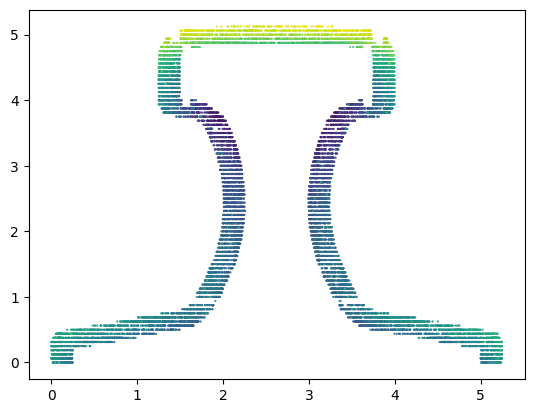

In [24]:
plt.scatter(dfv['lateral_inch'], dfv['relative_vertical_inch'], s=0.3, c=dfv['PCV'])

In [38]:
df = df.merge(dfv[['PCV']], left_index=True, right_index=True, how='left')

In [39]:
df

,Classification,Original_cloud_index,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,axial_inch_round,...,Nz,curvature,roughness_mean_abs,roughness_rms,roughness_std,DIP,DIPDIR,NORMDIP,NORMDIPDIR,PCV
0,2,0,0.330174,0.871877,0.393169,3.962087,10.462519,4.718032,3.9375,10.4375,...,0.415043,0.084266,0.868157,1.103043,0.680447,65.477987,359.949687,65.477987,359.949687,0.679688
1,2,0,0.111604,0.746168,0.350633,1.339252,8.954014,4.207599,1.3125,8.9375,...,0.153571,0.077296,0.958450,1.127828,0.594449,81.166086,0.182357,81.166086,0.182357,0.398438
2,2,0,0.317910,1.246824,0.386342,3.814921,14.961891,4.636103,3.8125,14.9375,...,0.349030,0.109690,0.888356,1.113748,0.671757,69.572013,0.019939,69.572013,0.019939,0.460938
3,2,0,0.114570,2.703832,0.327411,1.374843,32.445984,3.928936,1.3750,32.4375,...,0.469950,0.044343,0.978474,1.296502,0.850591,61.968969,359.973042,61.968969,359.973042,0.328125
4,2,0,0.115709,1.795413,0.386273,1.388504,21.544961,4.635275,1.3750,21.5625,...,0.342892,0.097707,0.877725,1.099093,0.661517,69.946814,179.612278,69.946814,179.612278,0.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,4,3,0.416138,0.036854,0.029596,4.993662,0.442243,0.355158,5.0000,0.4375,...,0.929420,0.030801,1.343398,1.565836,0.804441,21.655378,358.308865,21.655378,358.308865,NaN
199996,4,3,0.420961,0.415016,0.012598,5.051536,4.980196,0.151181,5.0625,5.0000,...,0.924296,0.025846,1.306586,1.538944,0.813130,22.437559,359.809935,22.437559,359.809935,NaN
199997,4,3,0.023346,2.614797,0.026030,0.280157,31.377559,0.312362,0.2500,31.3750,...,0.933247,0.021967,1.339528,1.564366,0.808026,21.053205,180.079187,21.053205,180.079187,NaN
199998,4,3,0.001424,2.521588,0.005614,0.017087,30.259055,0.067363,0.0000,30.2500,...,0.898805,0.030213,1.225253,1.487467,0.843393,25.998549,179.561775,25.998549,179.561775,NaN


In [64]:
n_total = len(df)
n_nan_before = df['PCV'].isna().sum()
print(f"NaN PCV rows: {n_nan_before} / {n_total} ({n_nan_before/n_total:.2%})")


NaN PCV rows: 0 / 199987 (0.00%)


In [ ]:
keys_inch = ['lateral_inch_round', 'vertical_inch_round']

pcv_map_i = (df.loc[df['PCV'].notna(), keys_inch + ['PCV']]
               .drop_duplicates(subset=keys_inch, keep='first'))

df = df.merge(pcv_map_i, on=keys_inch, how='left', suffixes=('', '_from_match'))

mask = df['PCV'].isna() & df['PCV_from_match'].notna()
df.loc[mask, 'PCV'] = df.loc[mask, 'PCV_from_match']
df = df.drop(columns=['PCV_from_match'])

n_nan_after = df['PCV'].isna().sum()
print(f"Filled {n_nan_before - n_nan_after} NaN PCV values using rounded-inch location match.")


Filled 101455 NaN PCV values using rounded-inch location match.


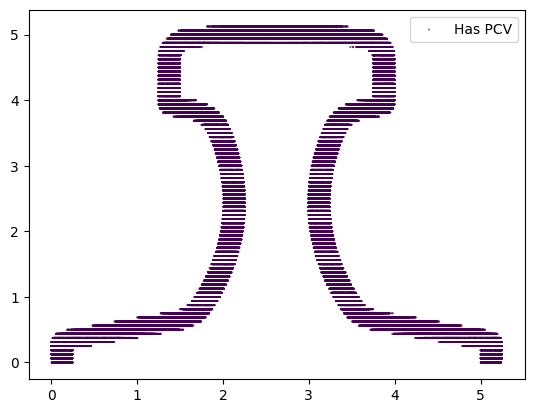

In [58]:
plt.scatter(df['lateral_inch'], df['relative_vertical_inch'], s=0.1, c=df['PCV'].isna())
plt.legend(['Has PCV', 'No PCV'])

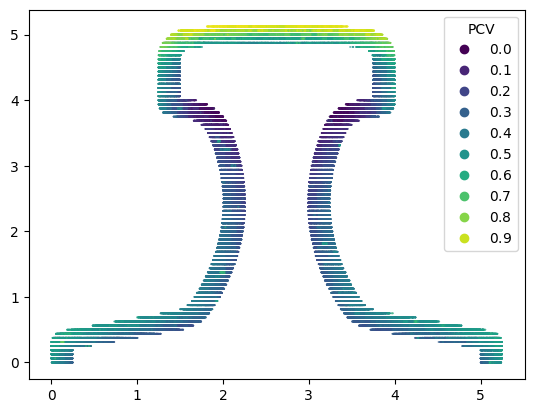

In [61]:
scatter = plt.scatter(df['lateral_inch'], df['relative_vertical_inch'], s=0.1, c=df['PCV'])
plt.legend(*scatter.legend_elements(), title="PCV")

In [63]:
df = df.dropna(subset=['PCV'])

In [65]:
n_total = len(df)
n_nan_before = df['PCV'].isna().sum()
print(f"NaN PCV rows: {n_nan_before} / {n_total} ({n_nan_before/n_total:.2%})")


NaN PCV rows: 0 / 199987 (0.00%)


In [28]:
def add_curvature_roughness_and_dip(
    df: pd.DataFrame,
    x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
    nx_col='Nx', ny_col='Ny', nz_col='Nz',
    lam1_col='lam1', lam2_col='lam2', lam3_col='lam3',
    radius: float | None = None,    # set exactly one of radius or k_neighbors
    k_neighbors: int | None = None,
    write_prefix: str = '',         # e.g., 'r6in_' if you compute multi-scale
    eps: float = 1e-12,
    verbose: bool = True
) -> pd.DataFrame:
    # Neighborhood guard
    if (radius is None) and (k_neighbors is None):
        raise ValueError("Specify one of radius or k_neighbors.")
    if (radius is not None) and (k_neighbors is not None):
        raise ValueError("Specify only one of radius or k_neighbors, not both.")

    # Required columns
    for c in (x_col, y_col, z_col, nx_col, ny_col, nz_col, lam1_col, lam2_col, lam3_col):
        if c not in df.columns:
            raise ValueError(f"Missing column '{c}' in DataFrame.")

    xyz = df[[x_col, y_col, z_col]].to_numpy(np.float64)
    normals = df[[nx_col, ny_col, nz_col]].to_numpy(np.float64)
    # Normalize normals for safety
    n_norm = np.linalg.norm(normals, axis=1, keepdims=True)
    normals = np.divide(normals, np.where(n_norm == 0, 1.0, n_norm),
                        out=np.zeros_like(normals), where=n_norm!=0)

    lam1 = df[lam1_col].to_numpy(np.float64)
    lam2 = df[lam2_col].to_numpy(np.float64)
    lam3 = df[lam3_col].to_numpy(np.float64)
    lam_sum = lam1 + lam2 + lam3 + eps

    # Curvature (aka surface variation)
    curvature = lam3 / lam_sum

    # Build KD-tree for roughness computation
    tree = cKDTree(xyz)

    N = xyz.shape[0]
    rough_mean = np.full(N, np.nan, dtype=np.float64)
    rough_rms  = np.full(N, np.nan, dtype=np.float64)
    rough_std  = np.full(N, np.nan, dtype=np.float64)

    # Pre-allocate DIP/DIPDIR
    DIP     = np.full(N, np.nan, dtype=np.float64)
    DIPDIR  = np.full(N, np.nan, dtype=np.float64)

    up = np.array([0.0, 0.0, 1.0])

    for i in range(N):
        p  = xyz[i]
        n  = normals[i]
        # Neighbor set
        if radius is not None:
            idx = tree.query_ball_point(p, r=radius)
        else:
            _, idx = tree.query(p, k=k_neighbors)
            if np.isscalar(idx):
                idx = [idx]
        P = xyz[idx]
        if len(P) >= 3 and np.isfinite(n).all() and np.linalg.norm(n) > 1e-9:
            # Plane through neighborhood centroid with normal n
            mu = P.mean(axis=0)
            d  = np.abs((P - mu) @ n)
            rough_mean[i] = d.mean()
            rough_rms[i]  = np.sqrt((d**2).mean())
            rough_std[i]  = d.std(ddof=0)
        else:
            rough_mean[i] = np.nan
            rough_rms[i]  = np.nan
            rough_std[i]  = np.nan

        # DIP (degrees): angle between plane and horizontal (= arccos(n·up))
        # Use |n·up| so sign/orientation doesn’t matter
        cang = np.clip(abs(np.dot(n, up)), 0.0, 1.0)
        DIP[i] = np.degrees(np.arccos(cang))  # 0° horizontal, 90° vertical

        # DIPDIR (degrees): azimuth of steepest descent
        # Projection of +Z onto the plane gives steepest ascent; negate for descent
        s_up = up - np.dot(up, n) * n
        s_dn = -s_up
        if np.linalg.norm(s_dn) < 1e-9:   # horizontal plane: undefined azimuth
            DIPDIR[i] = np.nan
        else:
            dipdir_rad = np.arctan2(s_dn[1], s_dn[0])    # from +X toward +Y
            DIPDIR[i]  = (np.degrees(dipdir_rad) + 360.0) % 360.0

        if verbose and (i % max(N//10, 1) == 0):
            print(f"Add curvature/roughness/dip: {i}/{N} ({100*i/N:.1f}%)")

    out = df.copy()
    # Curvature
    out[write_prefix + 'curvature'] = curvature
    # Roughness
    out[write_prefix + 'roughness_mean_abs'] = rough_mean
    out[write_prefix + 'roughness_rms']      = rough_rms
    out[write_prefix + 'roughness_std']      = rough_std
    # Dip & dip direction (duplicates under “NORM*” for convenience)
    out[write_prefix + 'DIP']      = DIP
    out[write_prefix + 'DIPDIR']   = DIPDIR
    out[write_prefix + 'NORMDIP']    = DIP
    out[write_prefix + 'NORMDIPDIR'] = DIPDIR

    return out

In [ ]:
df = add_curvature_roughness_and_dip(
    df,
    x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
    nx_col='Nx', ny_col='Ny', nz_col='Nz',
    lam1_col='lam1', lam2_col='lam2', lam3_col='lam3',
    radius=6.0,                 # or k_neighbors=30 (pick exactly one)
    write_prefix=''             # or 'r6in_' if you plan to add multi-scale later
)


Add curvature/roughness/dip: 0/200000 (0.0%)
Add curvature/roughness/dip: 20000/200000 (10.0%)
Add curvature/roughness/dip: 40000/200000 (20.0%)
Add curvature/roughness/dip: 60000/200000 (30.0%)
Add curvature/roughness/dip: 80000/200000 (40.0%)
Add curvature/roughness/dip: 100000/200000 (50.0%)
Add curvature/roughness/dip: 120000/200000 (60.0%)
Add curvature/roughness/dip: 140000/200000 (70.0%)
Add curvature/roughness/dip: 160000/200000 (80.0%)
Add curvature/roughness/dip: 180000/200000 (90.0%)


,Classification,Original_cloud_index,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,axial_inch_round,...,Ny,Nz,curvature,roughness_mean_abs,roughness_rms,roughness_std,DIP,DIPDIR,NORMDIP,NORMDIPDIR
0,2,0,0.330174,0.871877,0.393169,3.962087,10.462519,4.718032,3.9375,10.4375,...,-0.000799,0.415043,0.084266,0.868157,1.103043,0.680447,65.477987,359.949687,65.477987,359.949687
1,2,0,0.111604,0.746168,0.350633,1.339252,8.954014,4.207599,1.3125,8.9375,...,0.003145,0.153571,0.077296,0.958450,1.127828,0.594449,81.166086,0.182357,81.166086,0.182357
2,2,0,0.317910,1.246824,0.386342,3.814921,14.961891,4.636103,3.8125,14.9375,...,0.000326,0.349030,0.109690,0.888356,1.113748,0.671757,69.572013,0.019939,69.572013,0.019939
3,2,0,0.114570,2.703832,0.327411,1.374843,32.445984,3.928936,1.3750,32.4375,...,-0.000415,0.469950,0.044343,0.978474,1.296502,0.850591,61.968969,359.973042,61.968969,359.973042
4,2,0,0.115709,1.795413,0.386273,1.388504,21.544961,4.635275,1.3750,21.5625,...,0.006357,0.342892,0.097707,0.877725,1.099093,0.661517,69.946814,179.612278,69.946814,179.612278
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,4,3,0.416138,0.036854,0.029596,4.993662,0.442243,0.355158,5.0000,0.4375,...,-0.010890,0.929420,0.030801,1.343398,1.565836,0.804441,21.655378,358.308865,21.655378,358.308865
199996,4,3,0.420961,0.415016,0.012598,5.051536,4.980196,0.151181,5.0625,5.0000,...,-0.001266,0.924296,0.025846,1.306586,1.538944,0.813130,22.437559,359.809935,22.437559,359.809935
199997,4,3,0.023346,2.614797,0.026030,0.280157,31.377559,0.312362,0.2500,31.3750,...,-0.000496,0.933247,0.021967,1.339528,1.564366,0.808026,21.053205,180.079187,21.053205,180.079187
199998,4,3,0.001424,2.521588,0.005614,0.017087,30.259055,0.067363,0.0000,30.2500,...,0.003353,0.898805,0.030213,1.225253,1.487467,0.843393,25.998549,179.561775,25.998549,179.561775


In [69]:
df

,Classification,Original_cloud_index,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,axial_inch_round,...,Nz,curvature,roughness_mean_abs,roughness_rms,roughness_std,DIP,DIPDIR,NORMDIP,NORMDIPDIR,PCV
0,2,0,0.330174,0.871877,0.393169,3.962087,10.462519,4.718032,3.9375,10.4375,...,0.415043,0.084266,0.868157,1.103043,0.680447,65.477987,359.949687,65.477987,359.949687,0.679688
1,2,0,0.111604,0.746168,0.350633,1.339252,8.954014,4.207599,1.3125,8.9375,...,0.153571,0.077296,0.958450,1.127828,0.594449,81.166086,0.182357,81.166086,0.182357,0.398438
2,2,0,0.317910,1.246824,0.386342,3.814921,14.961891,4.636103,3.8125,14.9375,...,0.349030,0.109690,0.888356,1.113748,0.671757,69.572013,0.019939,69.572013,0.019939,0.460938
3,2,0,0.114570,2.703832,0.327411,1.374843,32.445984,3.928936,1.3750,32.4375,...,0.469950,0.044343,0.978474,1.296502,0.850591,61.968969,359.973042,61.968969,359.973042,0.328125
4,2,0,0.115709,1.795413,0.386273,1.388504,21.544961,4.635275,1.3750,21.5625,...,0.342892,0.097707,0.877725,1.099093,0.661517,69.946814,179.612278,69.946814,179.612278,0.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,4,3,0.416138,0.036854,0.029596,4.993662,0.442243,0.355158,5.0000,0.4375,...,0.929420,0.030801,1.343398,1.565836,0.804441,21.655378,358.308865,21.655378,358.308865,0.531250
199996,4,3,0.420961,0.415016,0.012598,5.051536,4.980196,0.151181,5.0625,5.0000,...,0.924296,0.025846,1.306586,1.538944,0.813130,22.437559,359.809935,22.437559,359.809935,0.429688
199997,4,3,0.023346,2.614797,0.026030,0.280157,31.377559,0.312362,0.2500,31.3750,...,0.933247,0.021967,1.339528,1.564366,0.808026,21.053205,180.079187,21.053205,180.079187,0.460938
199998,4,3,0.001424,2.521588,0.005614,0.017087,30.259055,0.067363,0.0000,30.2500,...,0.898805,0.030213,1.225253,1.487467,0.843393,25.998549,179.561775,25.998549,179.561775,0.515625


In [66]:
df.columns

Index(['Classification', 'Original_cloud_index', 'lateral', 'axial',
       'vertical', 'lateral_inch', 'axial_inch', 'vertical_inch',
       'lateral_inch_round', 'axial_inch_round', 'vertical_inch_round',
       'min_in_window', 'relative_vertical_inch', 'lam1', 'lam2', 'lam3',
       'e1x', 'e1y', 'e1z', 'e2x', 'e2y', 'e2z', 'e3x', 'e3y', 'e3z',
       'eigen_sum', 'omnivariance', 'eigenentropy', 'anisotropy', 'planarity',
       'linearity', 'surface_variation', 'sphericity', 'pca1', 'pca2',
       'verticality', 'O', 'neighbors', 'Nx', 'Ny', 'Nz', 'curvature',
       'roughness_mean_abs', 'roughness_rms', 'roughness_std', 'DIP', 'DIPDIR',
       'NORMDIP', 'NORMDIPDIR', 'PCV'],
      dtype='object')

In [73]:
dfa =df[df['lateral'] < df['lateral'].mean()].copy()
dfb =df[df['lateral'] > df['lateral'].mean()].copy()

In [74]:
dfa

,Classification,Original_cloud_index,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,axial_inch_round,...,Nz,curvature,roughness_mean_abs,roughness_rms,roughness_std,DIP,DIPDIR,NORMDIP,NORMDIPDIR,PCV
1,2,0,0.111604,0.746168,0.350633,1.339252,8.954014,4.207599,1.3125,8.9375,...,0.153571,0.077296,0.958450,1.127828,0.594449,81.166086,0.182357,81.166086,0.182357,0.398438
3,2,0,0.114570,2.703832,0.327411,1.374843,32.445984,3.928936,1.3750,32.4375,...,0.469950,0.044343,0.978474,1.296502,0.850591,61.968969,359.973042,61.968969,359.973042,0.328125
4,2,0,0.115709,1.795413,0.386273,1.388504,21.544961,4.635275,1.3750,21.5625,...,0.342892,0.097707,0.877725,1.099093,0.661517,69.946814,179.612278,69.946814,179.612278,0.500000
7,2,0,0.119836,2.717520,0.384623,1.438032,32.610237,4.615472,1.4375,32.6250,...,0.344907,0.112942,0.912119,1.141205,0.685847,69.823878,179.435429,69.823878,179.435429,0.406250
8,2,0,0.118255,0.378189,0.363635,1.419055,4.538267,4.363621,1.4375,4.5625,...,0.042559,0.104125,0.959499,1.109088,0.556272,87.560831,178.897035,87.560831,178.897035,0.328125
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199990,4,3,0.038688,1.155082,0.027802,0.464252,13.860983,0.333622,0.4375,13.8750,...,0.949198,0.019017,1.356360,1.568324,0.787355,18.341438,181.225996,18.341438,181.225996,0.351562
199992,4,3,0.126759,2.096040,0.054075,1.521102,25.152480,0.648897,1.5000,25.1250,...,0.844299,0.035744,1.241658,1.519597,0.876048,32.403092,181.822400,32.403092,181.822400,0.367188
199993,4,3,0.155184,0.054655,0.307982,1.862205,0.655865,3.695787,1.8750,0.6250,...,0.529745,0.028228,0.992726,1.329795,0.884788,58.011787,358.149382,58.011787,358.149382,0.218750
199997,4,3,0.023346,2.614797,0.026030,0.280157,31.377559,0.312362,0.2500,31.3750,...,0.933247,0.021967,1.339528,1.564366,0.808026,21.053205,180.079187,21.053205,180.079187,0.460938


In [75]:
dfb

,Classification,Original_cloud_index,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,axial_inch_round,...,Nz,curvature,roughness_mean_abs,roughness_rms,roughness_std,DIP,DIPDIR,NORMDIP,NORMDIPDIR,PCV
0,2,0,0.330174,0.871877,0.393169,3.962087,10.462519,4.718032,3.9375,10.4375,...,0.415043,0.084266,0.868157,1.103043,0.680447,65.477987,359.949687,65.477987,359.949687,0.679688
2,2,0,0.317910,1.246824,0.386342,3.814921,14.961891,4.636103,3.8125,14.9375,...,0.349030,0.109690,0.888356,1.113748,0.671757,69.572013,0.019939,69.572013,0.019939,0.460938
5,2,0,0.322812,2.841939,0.404144,3.873740,34.103268,4.849725,3.8750,34.1250,...,0.588813,0.083200,0.925921,1.220324,0.794896,53.927183,1.932471,53.927183,1.932471,0.726562
6,2,0,0.316949,1.451827,0.350092,3.803386,17.421929,4.201102,3.8125,17.4375,...,0.163894,0.086048,0.961197,1.135631,0.604779,80.567000,180.115423,80.567000,180.115423,0.257812
9,2,0,0.327743,1.601020,0.335397,3.932914,19.212244,4.024764,3.9375,19.1875,...,0.372763,0.053700,0.964133,1.228496,0.761348,68.113899,180.006720,68.113899,180.006720,0.398438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199991,4,3,0.272831,1.644324,0.298573,3.273976,19.731890,3.582874,3.2500,19.7500,...,0.508269,0.029974,0.973619,1.303602,0.866859,59.451429,179.840688,59.451429,179.840688,0.085938
199994,4,3,0.430479,2.290180,0.027375,5.165748,27.482165,0.328504,5.1875,27.5000,...,0.921874,0.027721,1.291774,1.524365,0.809326,22.798373,359.297667,22.798373,359.297667,0.539062
199995,4,3,0.416138,0.036854,0.029596,4.993662,0.442243,0.355158,5.0000,0.4375,...,0.929420,0.030801,1.343398,1.565836,0.804441,21.655378,358.308865,21.655378,358.308865,0.531250
199996,4,3,0.420961,0.415016,0.012598,5.051536,4.980196,0.151181,5.0625,5.0000,...,0.924296,0.025846,1.306586,1.538944,0.813130,22.437559,359.809935,22.437559,359.809935,0.429688


## EXAMINE CROSS-SECTION OF EACH RAIL FOR ALL FEATURES

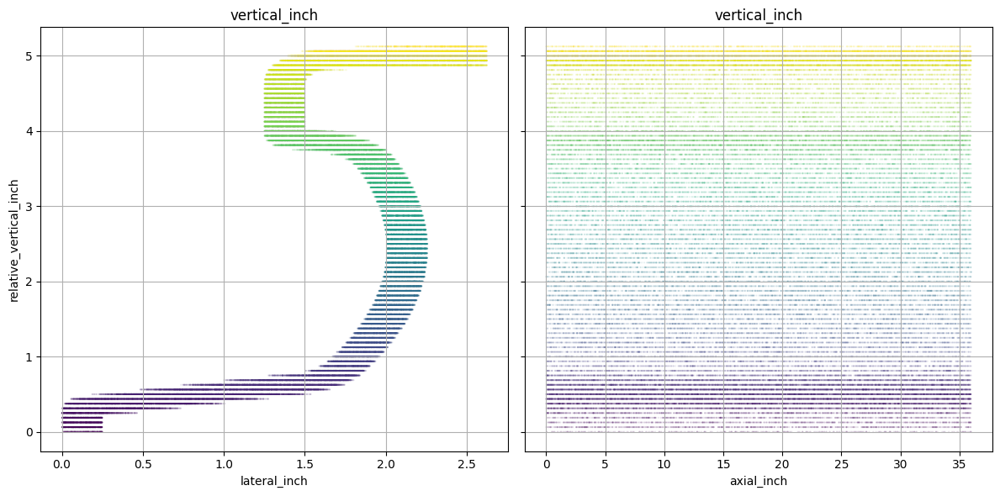

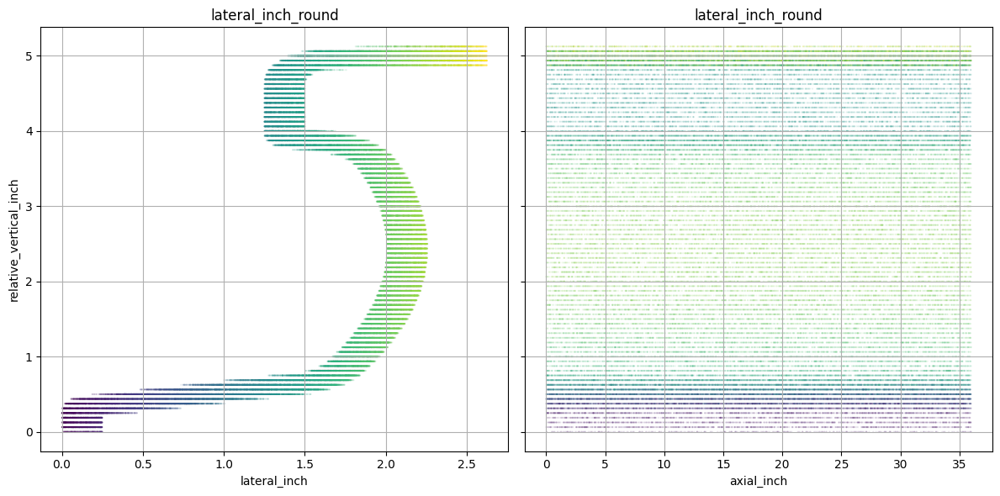

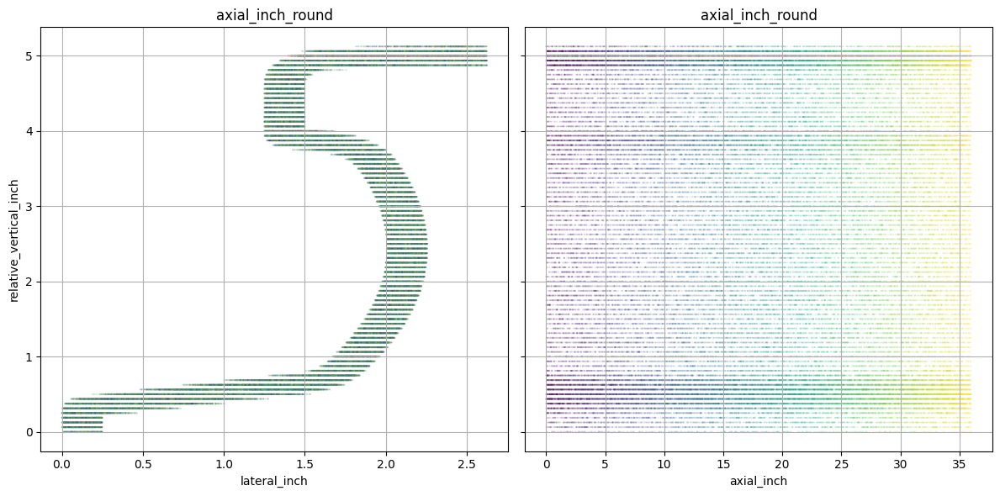

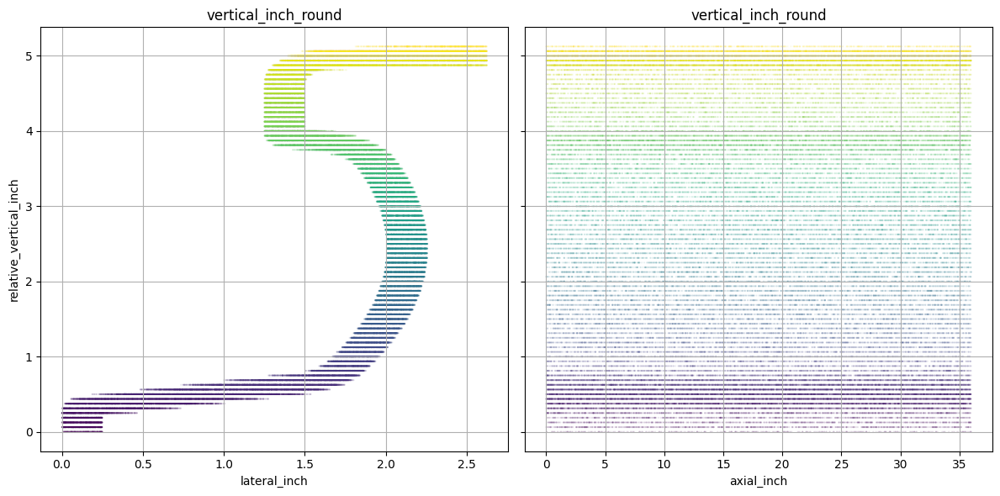

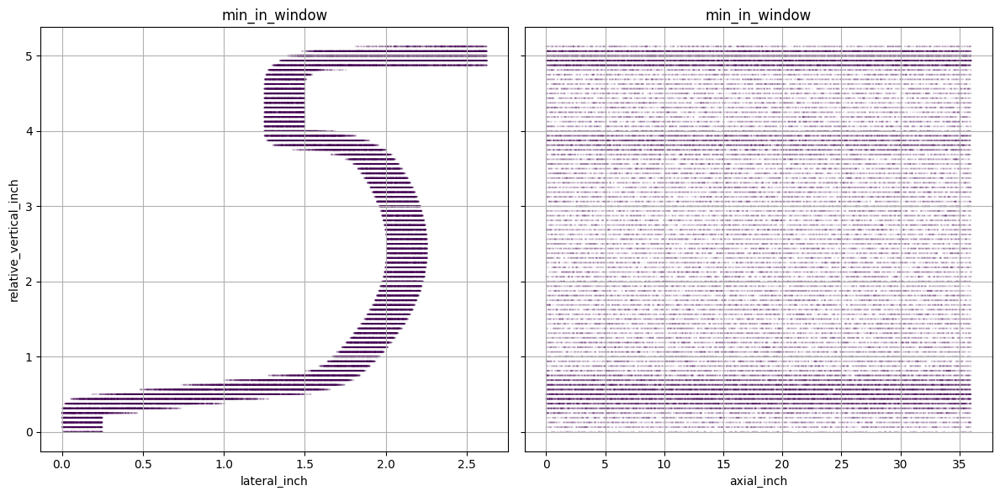

...

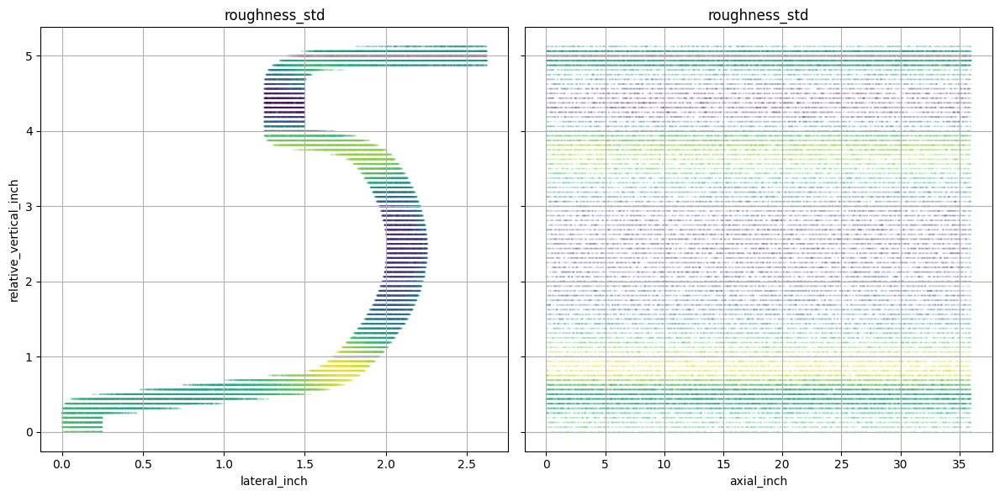

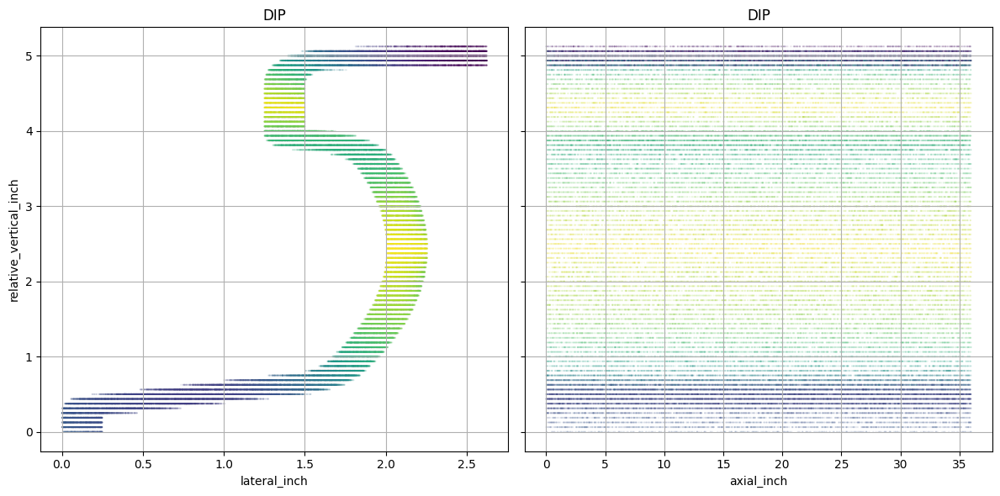

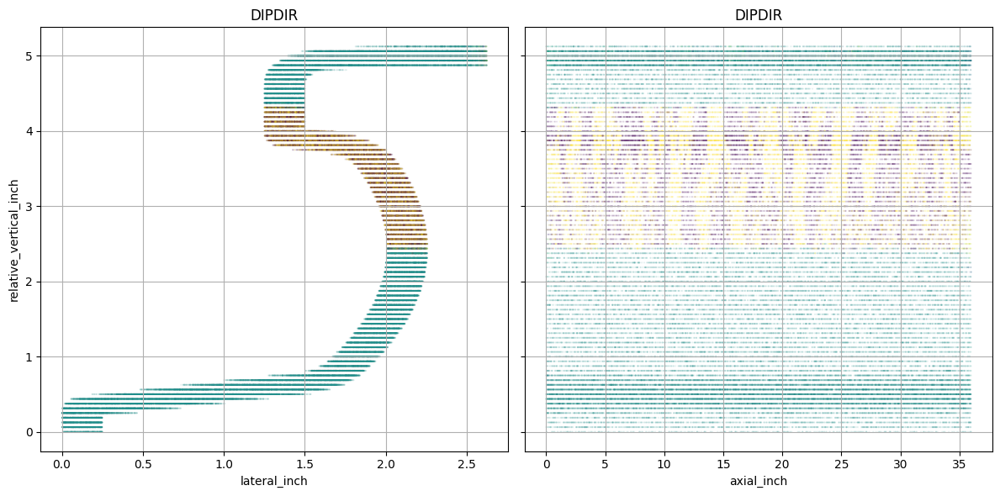

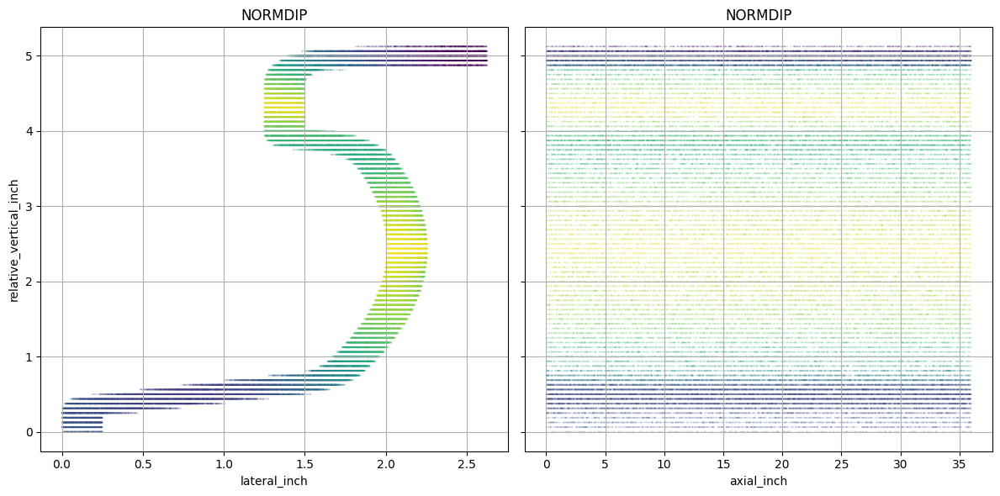

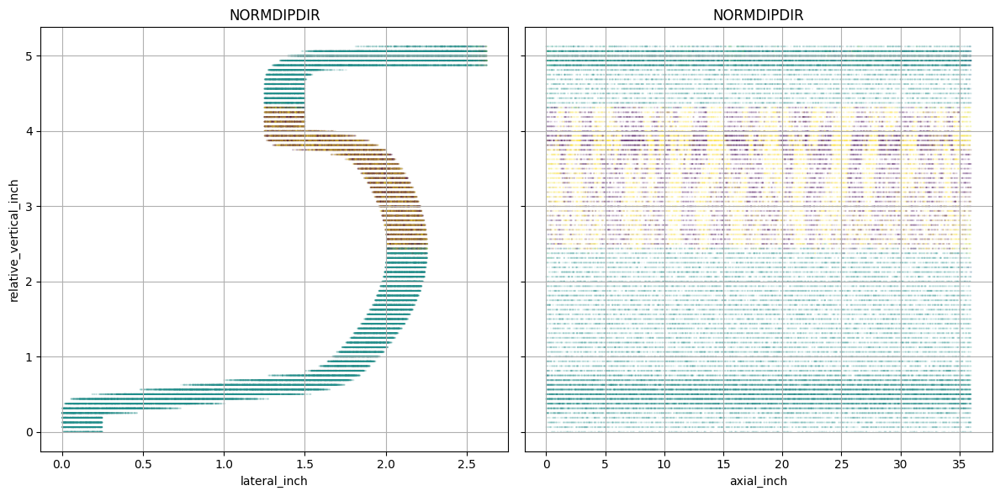

In [76]:
cols = ['vertical_inch', 'lateral_inch_round', 'axial_inch_round',
       'vertical_inch_round', 'min_in_window', 'relative_vertical_inch',
       'lam1', 'lam2', 'lam3', 'e1x', 'e1y', 'e1z', 'e2x', 'e2y', 'e2z', 'e3x',
       'e3y', 'e3z', 'eigen_sum', 'omnivariance', 'eigenentropy', 'anisotropy',
       'planarity', 'linearity', 'surface_variation', 'sphericity', 'pca1',
       'pca2', 'verticality', 'O', 'neighbors', 'Nx', 'Ny', 'Nz', 'PCV',
       'curvature', 'roughness_mean_abs', 'roughness_rms', 'roughness_std',
       'DIP', 'DIPDIR', 'NORMDIP', 'NORMDIPDIR']

for col in cols:
    fig, axes = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

    axes[0].scatter(dfa['lateral_inch'], dfa['relative_vertical_inch'], s=0.3, alpha=0.1, c=dfa[col])
    axes[0].set_title(col)
    axes[0].set_xlabel('lateral_inch')
    axes[0].set_ylabel('relative_vertical_inch')
    axes[0].grid(True)

    axes[1].scatter(dfa['axial_inch'], dfa['relative_vertical_inch'], s=0.3, alpha=0.1, c=dfa[col])
    axes[1].set_title(col)
    axes[1].set_xlabel('axial_inch')
    axes[1].grid(True)
 
    plt.tight_layout()
    plt.show()

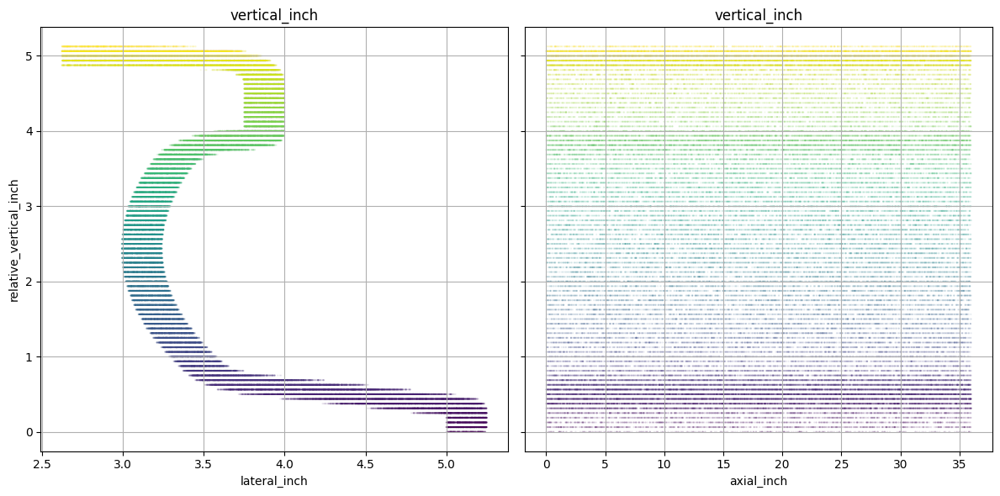

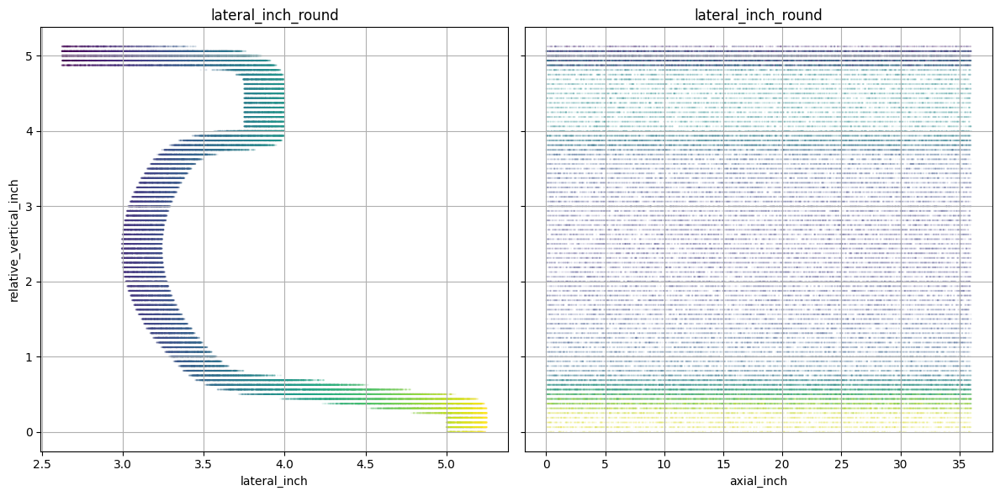

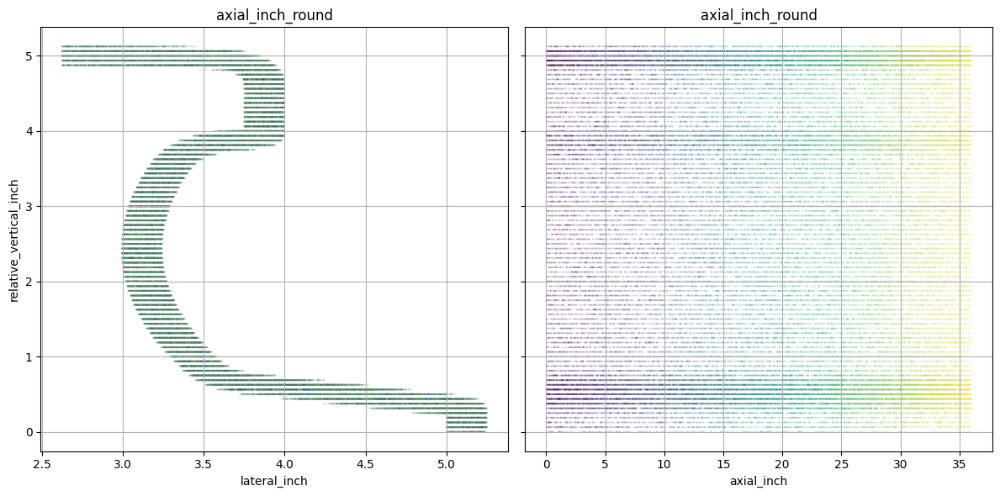

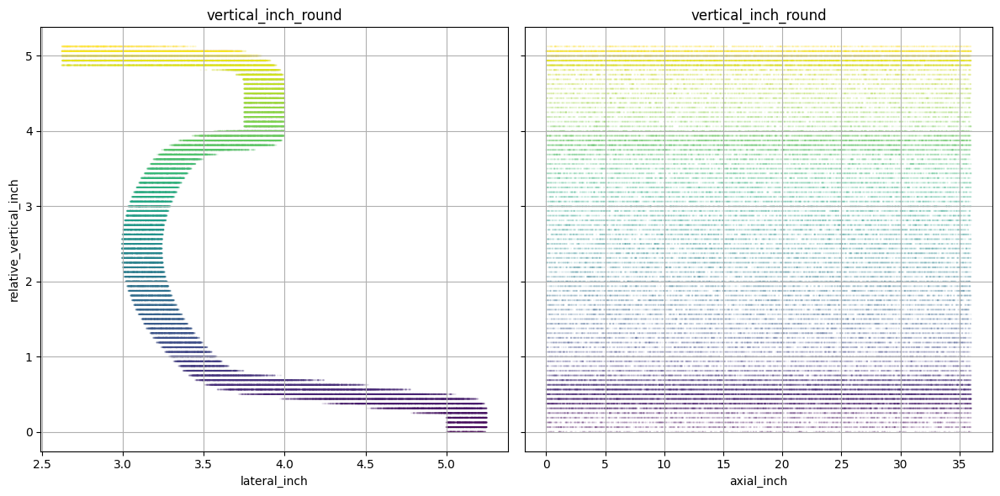

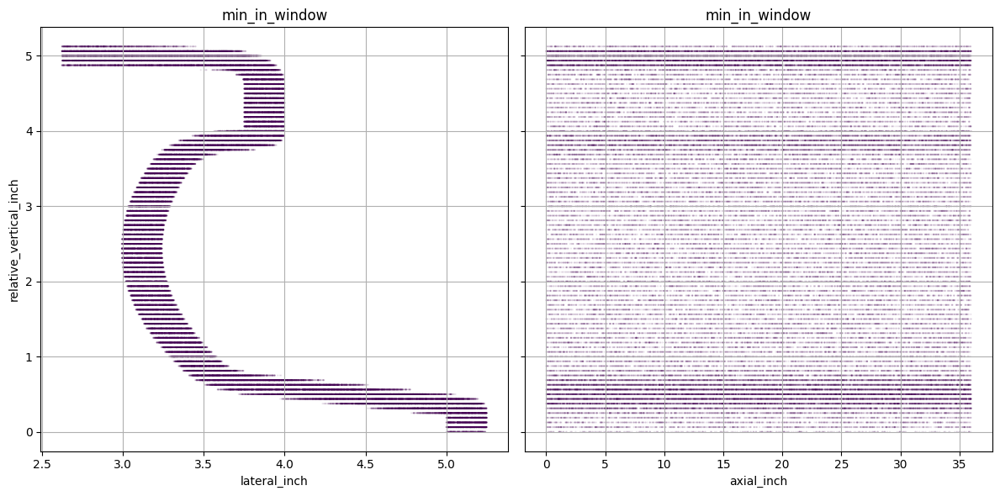

...

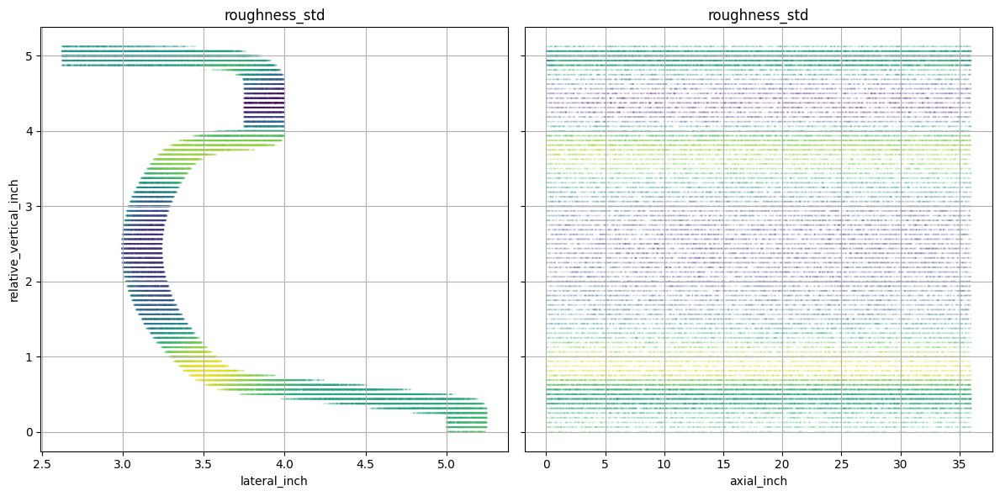

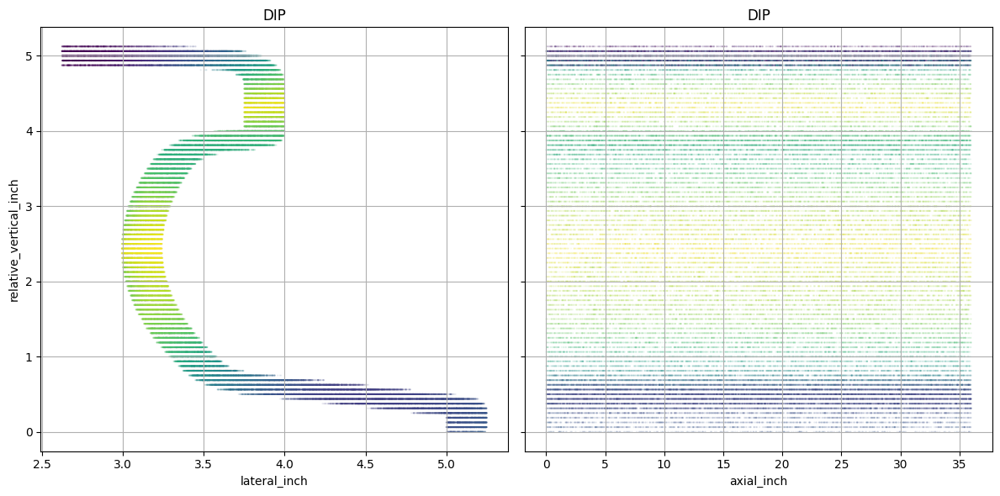

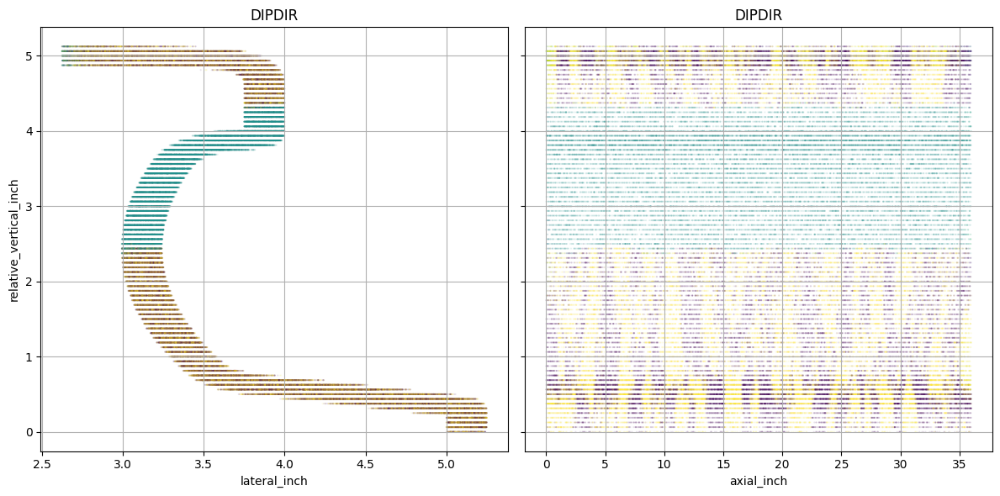

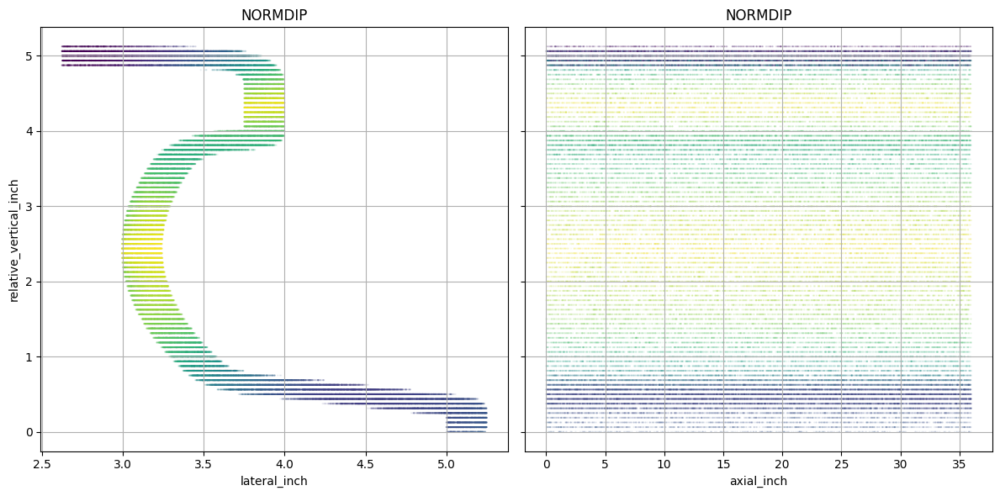

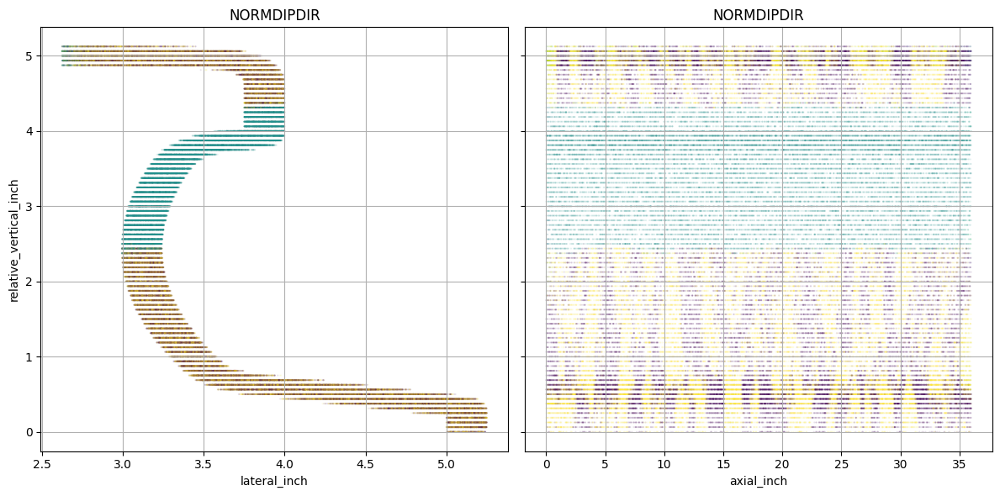

In [77]:
for col in cols:
    fig, axes = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

    axes[0].scatter(dfb['lateral_inch'], dfb['relative_vertical_inch'], s=0.3, alpha=0.1, c=dfb[col])
    axes[0].set_title(col)
    axes[0].set_xlabel('lateral_inch')
    axes[0].set_ylabel('relative_vertical_inch')
    axes[0].grid(True)

    axes[1].scatter(dfb['axial_inch'], dfb['relative_vertical_inch'], s=0.3, alpha=0.1, c=dfb[col])
    axes[1].set_title(col)
    axes[1].set_xlabel('axial_inch')
    axes[1].grid(True)
 
    plt.tight_layout()
    plt.show()

In [78]:
nan_counts_all = df.isna().sum()
nan_counts_all

Classification            0
Original_cloud_index      0
lateral                   0
axial                     0
vertical                  0
lateral_inch              0
axial_inch                0
vertical_inch             0
lateral_inch_round        0
axial_inch_round          0
vertical_inch_round       0
min_in_window             0
relative_vertical_inch    0
lam1                      0
lam2                      0
lam3                      0
e1x                       0
e1y                       0
e1z                       0
e2x                       0
e2y                       0
e2z                       0
e3x                       0
e3y                       0
e3z                       0
eigen_sum                 0
omnivariance              0
eigenentropy              0
anisotropy                0
planarity                 0
linearity                 0
surface_variation         0
sphericity                0
pca1                      0
pca2                      0
verticality         

In [79]:
df = df.dropna()

In [80]:
df.to_csv('data/df_featured_ideal.csv', index=False)